<a href="https://colab.research.google.com/github/martintmv-git/RB-IBDM/blob/main/Experiments/SIFT/SIFT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SIFT Experiment for Insect Segmentation in Floral Backgrounds

This notebook demonstrates a computer vision pipeline for segmenting insects from images with complex floral backgrounds. The initial section explores feature detection using SIFT to identify unique aspects of the insects.

The purpose of this analysis is to fine-tune image preprocessing steps for insect classification for DIOPSIS cameras and algorithms that run only on yellow background and fail on floral backgrounds.

In [ ]:
# Import necessary libraries
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
from sklearn.cluster import KMeans
from google.colab.patches import cv2
from google.colab.patches import cv2_imshow

Image 1 SIFT Features


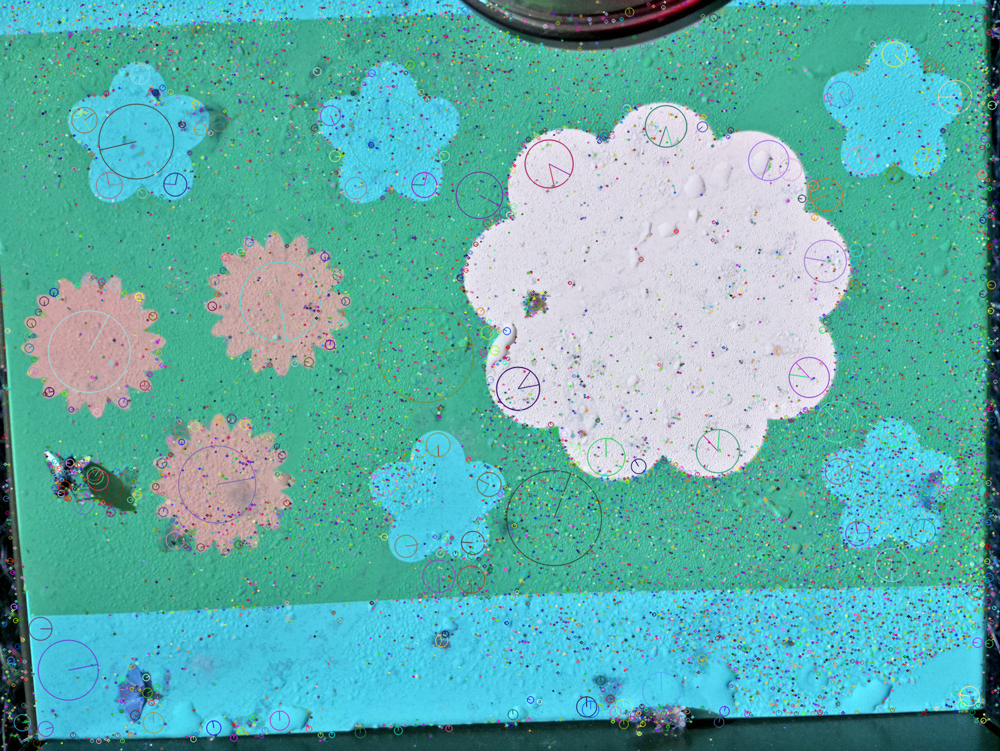



Image 2 SIFT Features


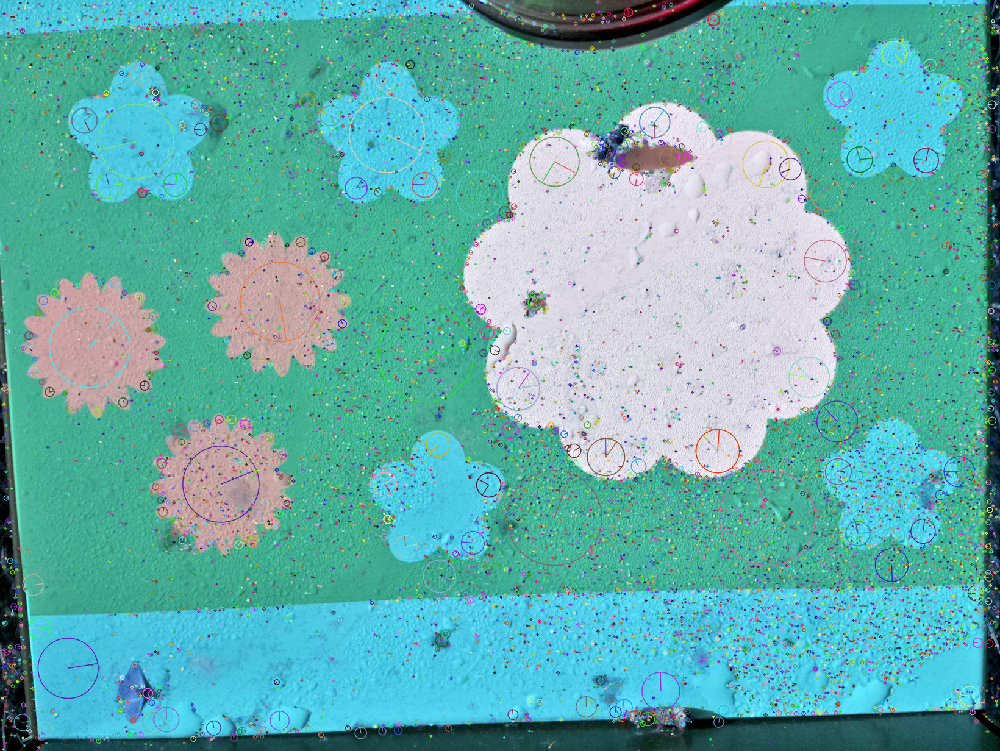



Image 3 SIFT Features


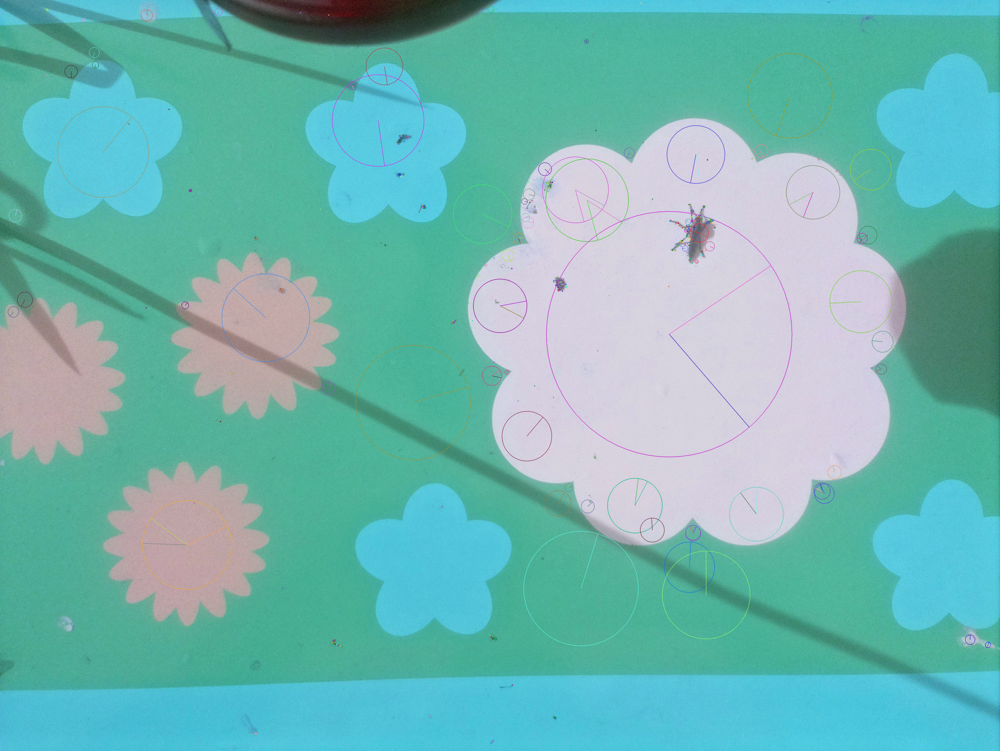



Image 4 SIFT Features


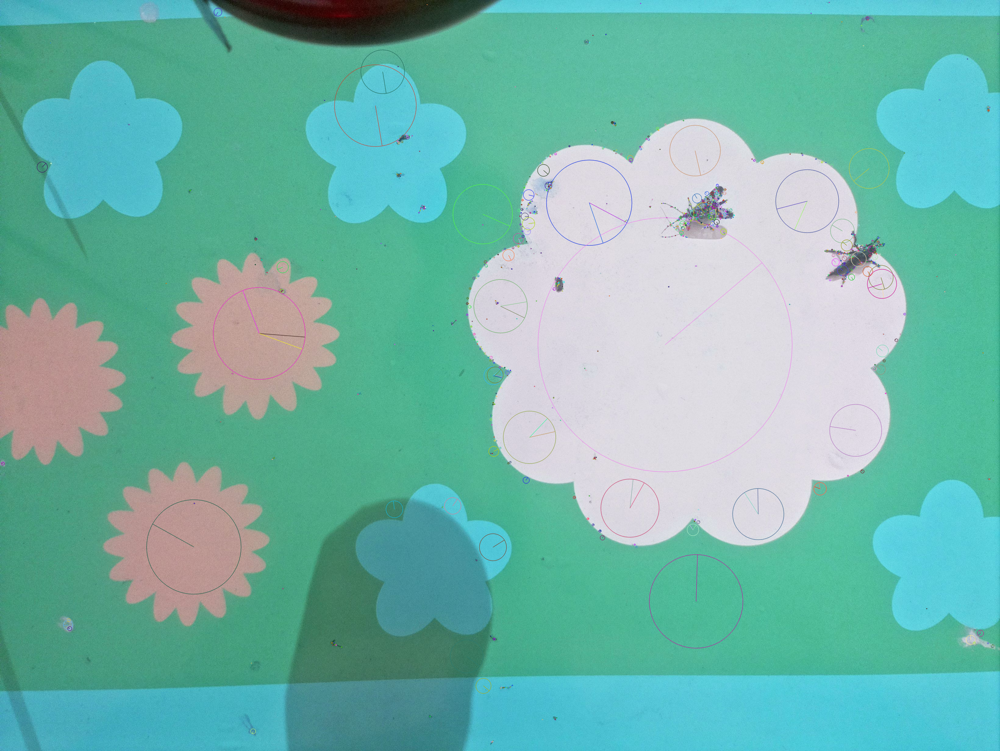



Image 5 SIFT Features


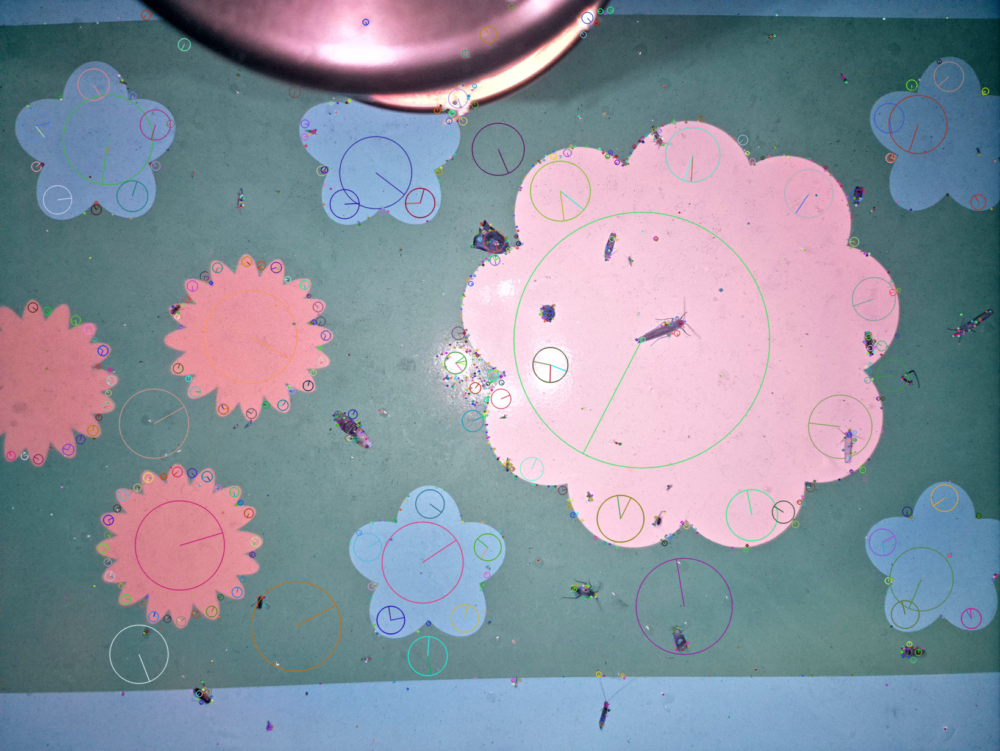



Image 6 SIFT Features


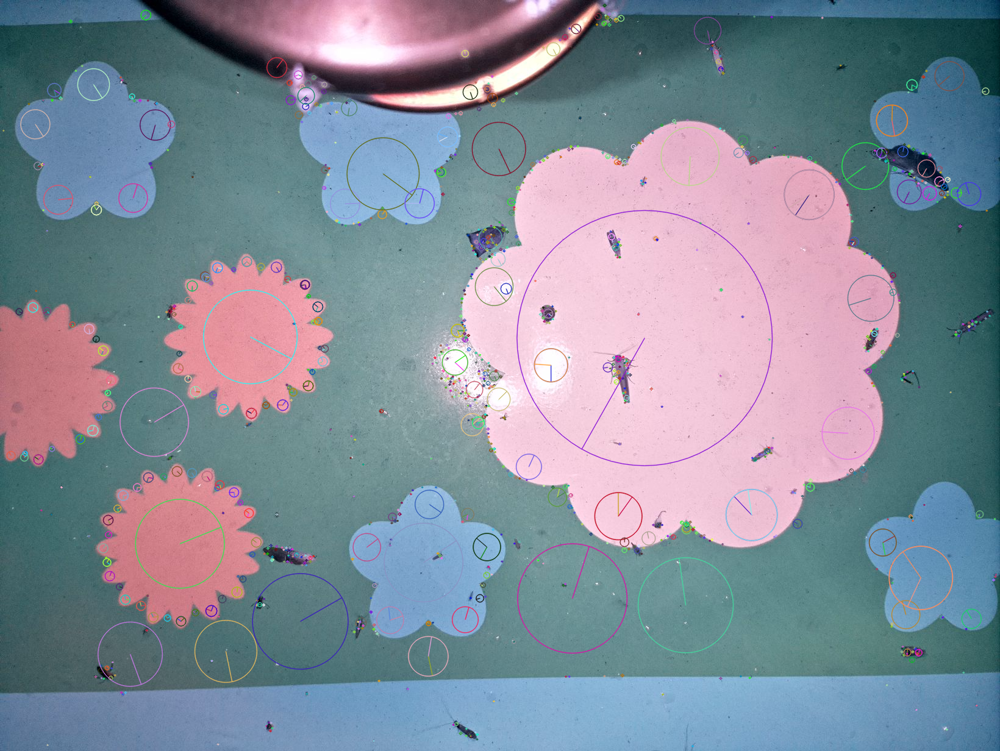

In [ ]:
# Function to load images from Google Drive or upload
def load_images_from_colab(filepaths):
    images = []
    for filepath in filepaths:
        image = cv.imread(filepath)
        image_rgb = cv.cvtColor(image, cv.COLOR_BGR2RGB)
        images.append(image_rgb)
    return images

# Function to display images using cv2_imshow in Colab
def display_images_colab(images):
    for image in images:
        cv2_imshow(image)
        print("\n")

# Function to compute SIFT features
def compute_sift_features(images):
    keypoints_all = []
    descriptors_all = []
    for image in images:
        keypoints, descriptors = sift.detectAndCompute(image, None)
        keypoints_all.append(keypoints)
        descriptors_all.append(descriptors)
    return keypoints_all, descriptors_all

# Function to display SIFT features on the images for Colab
def plot_sift_features_colab(images, keypoints):
    for i, (image, kp) in enumerate(zip(images, keypoints)):
        image_with_keypoints = cv.drawKeypoints(image, kp, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        print(f"Image {i+1} SIFT Features")
        cv2_imshow(image_with_keypoints)
        print("\n")

# Initialize SIFT detector
sift = cv.SIFT_create()

filepaths = ['/flower-day-1.jpeg', '/flower-day-2.jpeg', '/flower-day-3.jpeg', '/flower-day-4.jpeg', '/flower-night-1.jpg', '/flower-night-2.jpg']
images = load_images_from_colab(filepaths)

# Compute SIFT features
keypoints, descriptors = compute_sift_features(images)

# Display SIFT features
plot_sift_features_colab(images, keypoints)


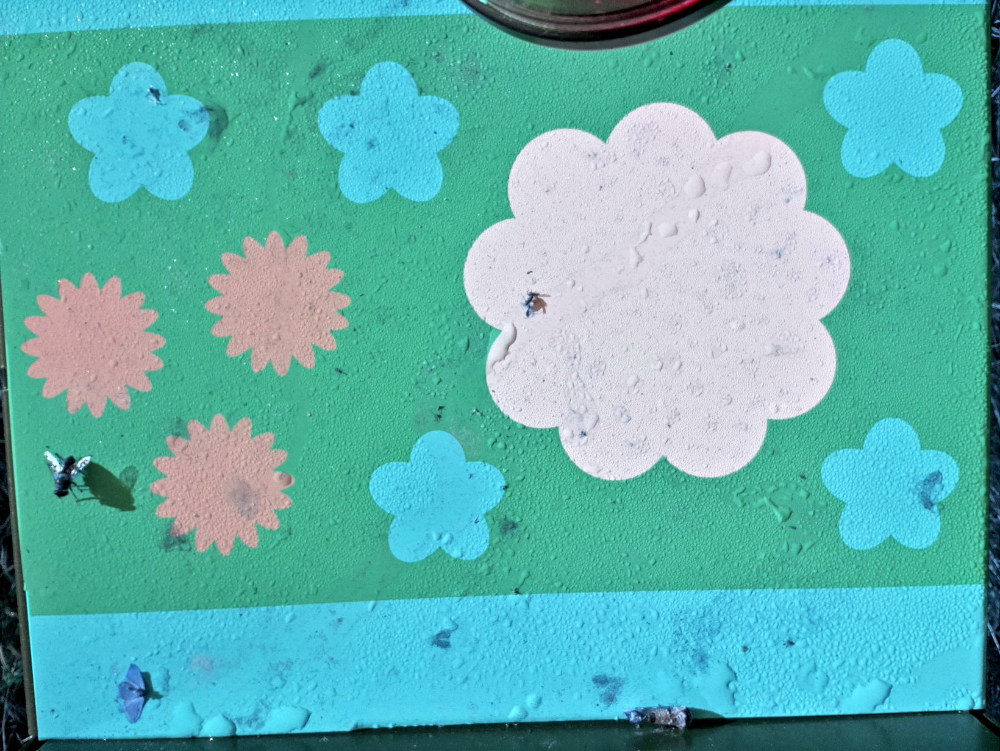

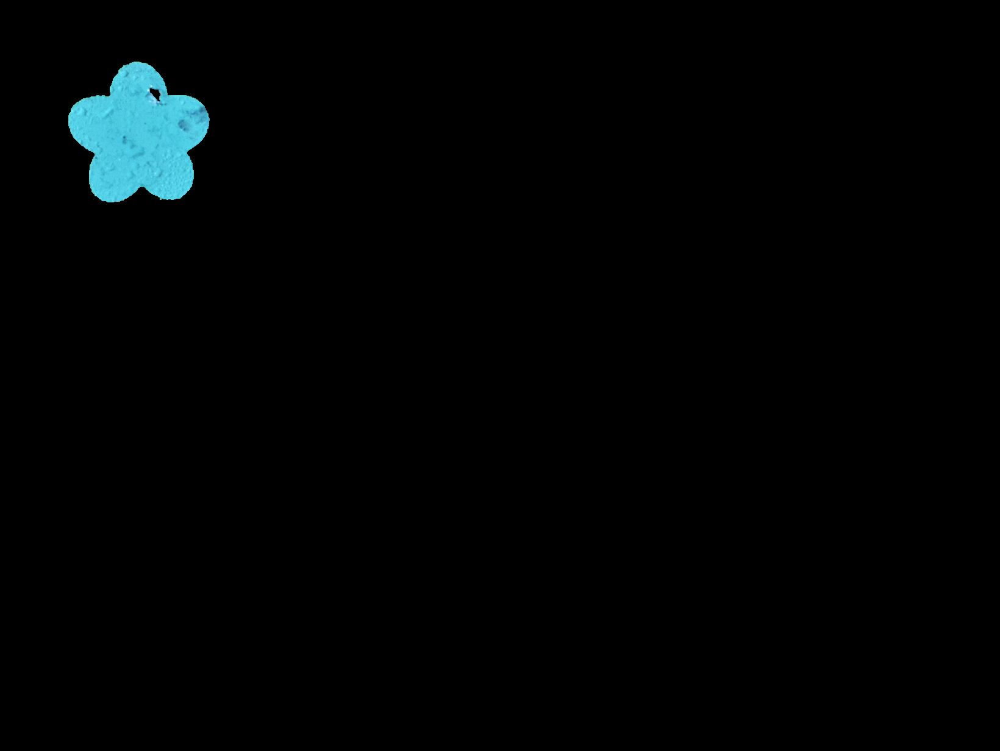

In [ ]:
def apply_grabcut(image, rect):
    # Initialize mask, bgdModel, fgdModel
    mask = np.zeros(image.shape[:2], np.uint8)
    bgdModel = np.zeros((1, 65), np.float64)
    fgdModel = np.zeros((1, 65), np.float64)

    # Apply GrabCut
    cv.grabCut(image, mask, rect, bgdModel, fgdModel, 5, cv.GC_INIT_WITH_RECT)

    # Modify mask such that all 0 and 2 pixels are converted to the background
    # 0 and 2 denotes the background and probable background respectively
    mask2 = np.where((mask == 2) | (mask == 0), 0, 1).astype('uint8')

    # The insects should not be segmented out as they are not within the rectangle
    image_rgb_nobg = image * mask2[:, :, np.newaxis]

    return image_rgb_nobg

# Display the result for the first image to tune the rectangle
# Define a rectangle around the region of the background
rect = (50, 50, 450, 290)  # (start_x, start_y, width, height)

# Apply GrabCut to the first image
image_segmented = apply_grabcut(images[0], rect)

# Show the original and the segmented image
cv2_imshow(images[0])
cv2_imshow(image_segmented)

Option 1


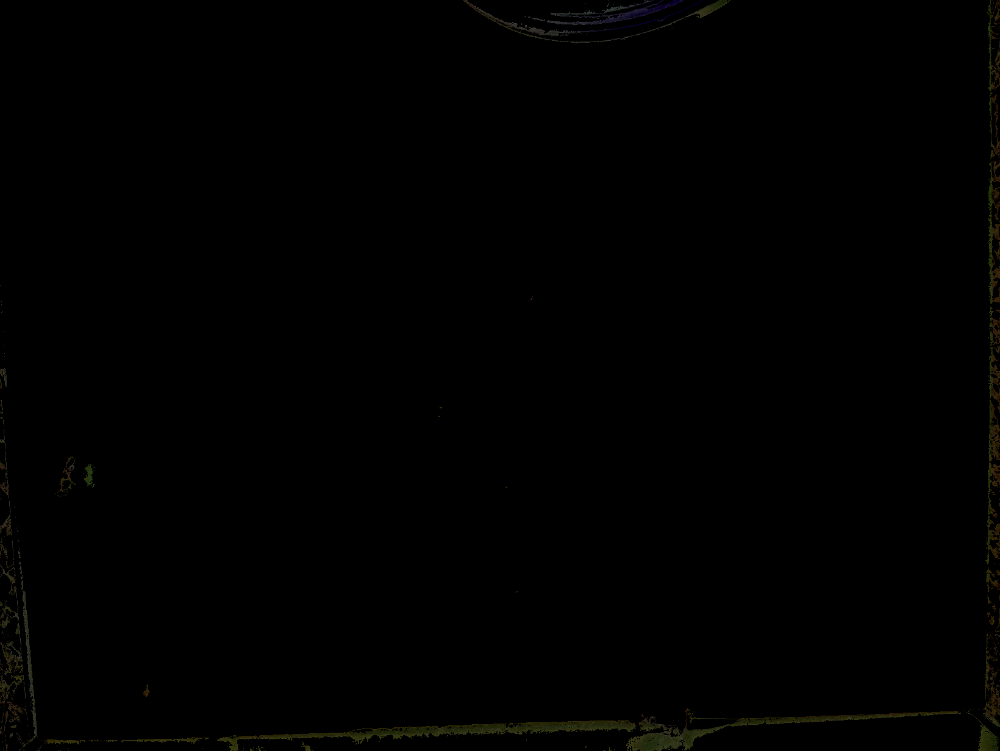

Option 2


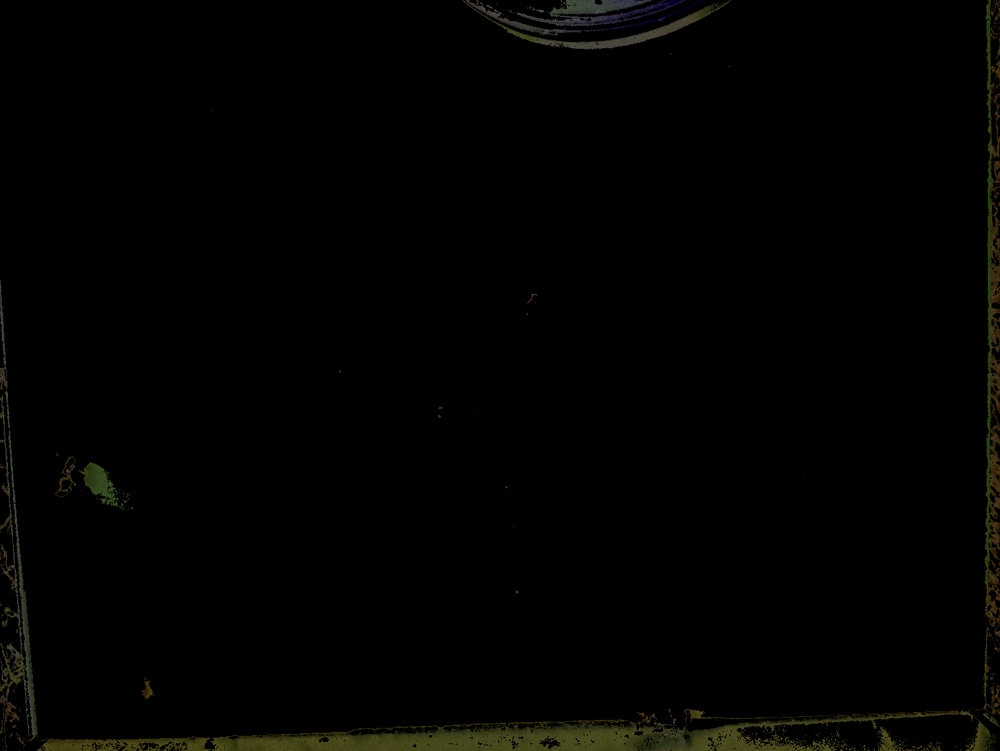

Option 3


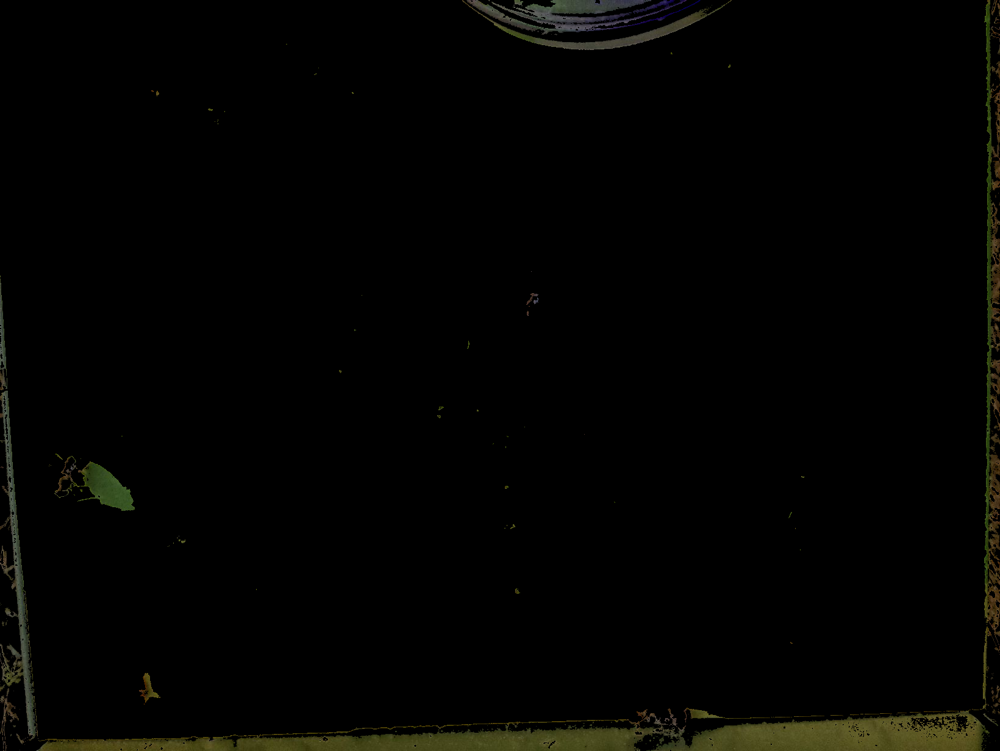

Option 4


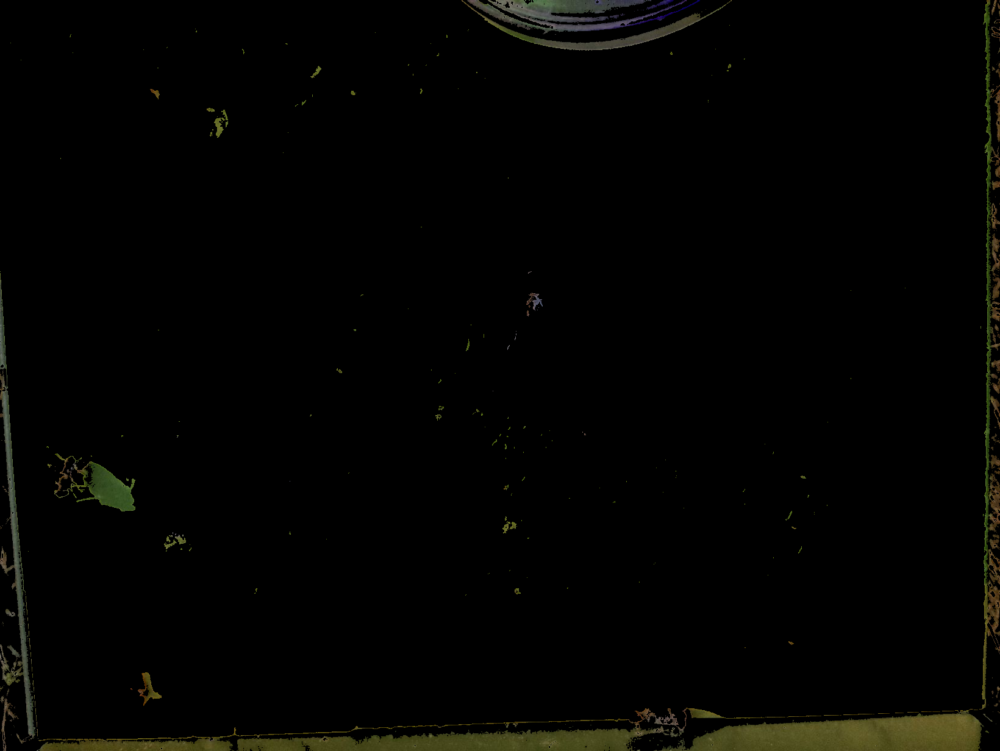

Option 5


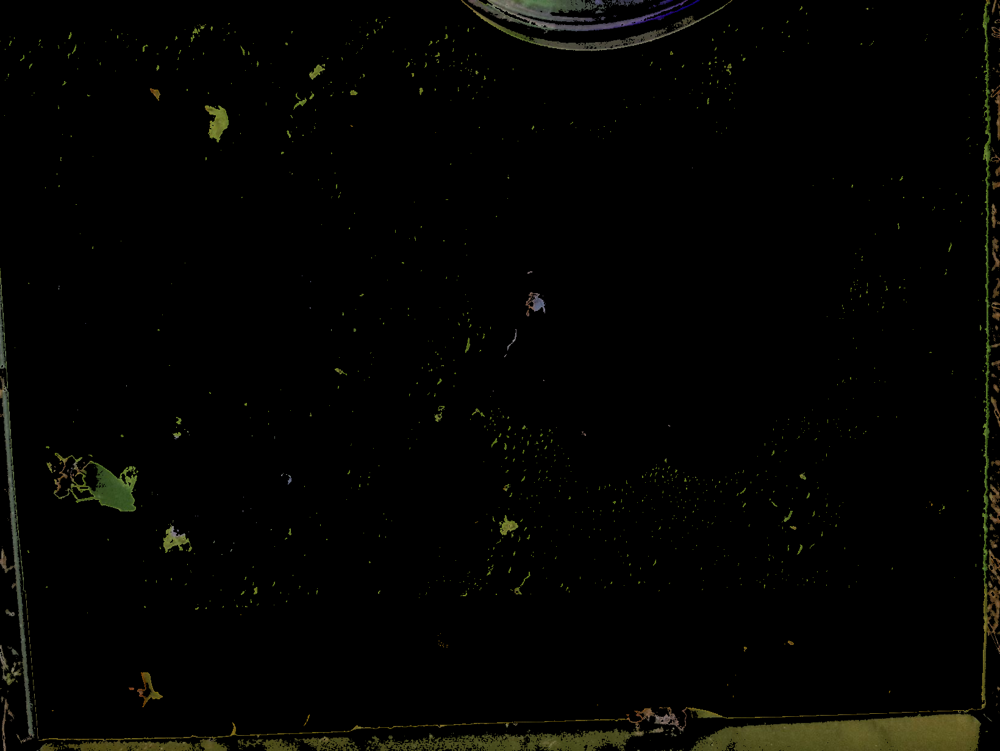

Option 6


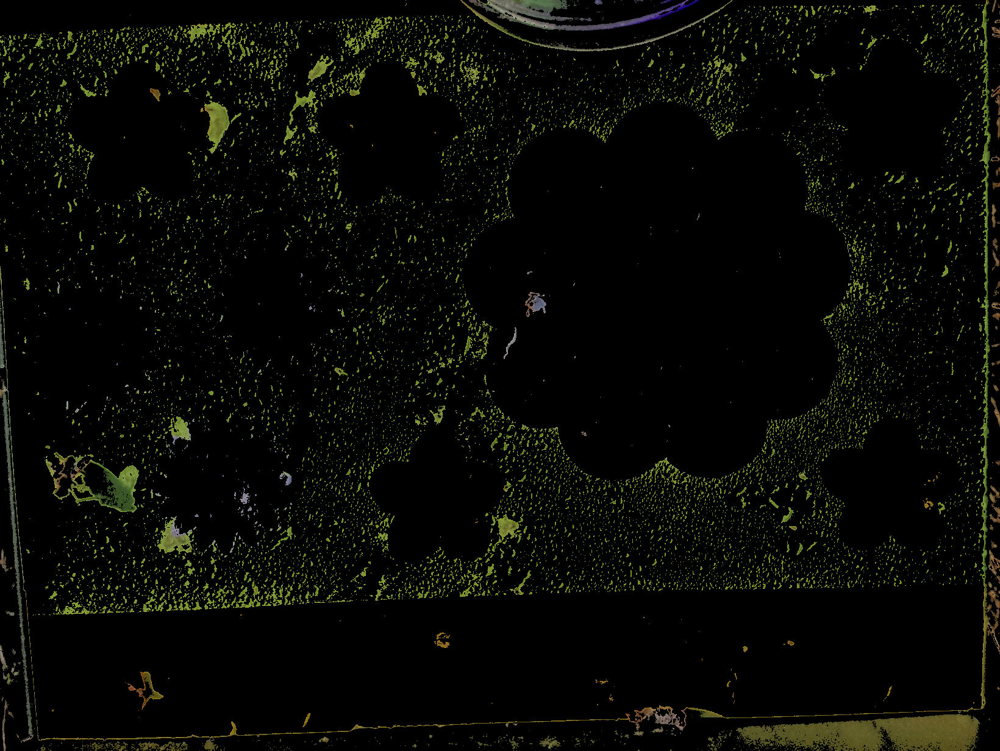

Option 7


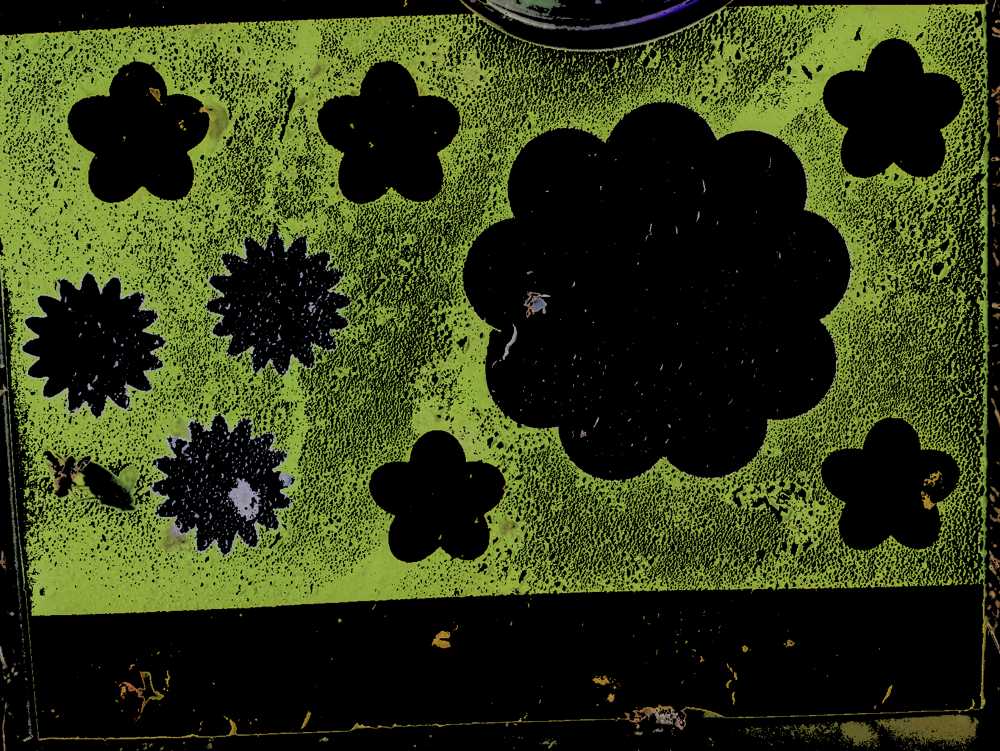

In [ ]:
# Load the image
image = cv.imread('/flower-day-1.jpeg')
hsv_image = cv.cvtColor(image, cv.COLOR_BGR2HSV)

# Define different color ranges to try
color_ranges = [
    (np.array([0, 0, 30]), np.array([179, 255, 60])),   # Option 1: Dark colors with a bit more brightness
    (np.array([0, 0, 40]), np.array([179, 255, 80])),   # Option 2: Dark to mid-range brightness
    (np.array([0, 0, 50]), np.array([179, 255, 100])),  # Option 3: Increasing brightness
    (np.array([0, 0, 60]), np.array([179, 255, 120])),  # Option 4: Brighter objects, could still be insects
    (np.array([0, 0, 70]), np.array([179, 255, 140])),  # Option 5: Even brighter objects
    (np.array([0, 0, 80]), np.array([179, 255, 160])),  # Option 6: Further increased brightness
    (np.array([0, 0, 90]), np.array([179, 255, 180])),  # Option 7: Near the upper end of brightness
]

# Apply each color range to segment the insects
for i, (lower_color, upper_color) in enumerate(color_ranges, 1):
    mask = cv.inRange(hsv_image, lower_color, upper_color)
    segmented_insects = cv.bitwise_and(image, image, mask=mask)
    print(f"Option {i}")
    cv2_imshow(segmented_insects)